In [1]:
import couchdb
import folium
from folium import Choropleth
from folium.plugins import HeatMap, MarkerCluster
import random
import geopandas as gpd
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point

In [2]:
user = "admin"
password = "admin"
couchserver = couchdb.Server("http://%s:%s@172.26.134.187:5984/" % (user, password))

### Suburbs

In [33]:
suburbs = gpd.read_file('./localities/vic.shp')
suburbs = suburbs.drop(columns=['LC_PLY_PID', 'LOC_PID', "DT_CREATE", "LOC_CLASS", "STATE"])

In [34]:
suburbs = suburbs[["LOC_NAME", "geometry"]].set_index("LOC_NAME")

In [35]:
suburbs

,geometry
LOC_NAME,
Abbeyard,"POLYGON ((146.81721 -37.09735, 146.81729 -37.0..."
Abbotsford,"POLYGON ((145.00235 -37.80723, 145.00350 -37.8..."
Aberfeldie,"POLYGON ((144.89830 -37.76465, 144.89790 -37.7..."
Aberfeldy,"POLYGON ((146.39447 -37.71008, 146.39405 -37.7..."
Acheron,"POLYGON ((145.75030 -37.24313, 145.75036 -37.2..."
...,...
Yundool,"POLYGON ((145.85808 -36.26996, 145.85813 -36.2..."
Yuroke,"POLYGON ((144.87770 -37.58472, 144.87867 -37.5..."
Yuulong,"POLYGON ((143.29976 -38.75116, 143.29895 -38.7..."


In [36]:
suburbsToKeep = pd.read_csv("greater_melbourne.txt", header=None)

In [37]:
suburbs = suburbs.loc[suburbsToKeep[0]]

In [38]:
suburbs

,geometry
LOC_NAME,
Melbourne,"POLYGON ((144.97797 -37.83867, 144.97803 -37.8..."
St Kilda,"POLYGON ((144.99038 -37.87073, 144.99036 -37.8..."
Southbank,"POLYGON ((144.95308 -37.82740, 144.95328 -37.8..."
Woori Yallock,"POLYGON ((145.56403 -37.79782, 145.56412 -37.7..."
Carlton,"POLYGON ((144.97401 -37.80311, 144.97320 -37.8..."
...,...
Grangefields,"POLYGON ((144.64630 -37.70140, 144.64632 -37.7..."
Wesburn,"POLYGON ((145.60867 -37.77043, 145.60842 -37.7..."
Steels Creek,"POLYGON ((145.39431 -37.59546, 145.39427 -37.5..."


In [39]:
suburbData = suburbs.copy(deep=True)

### Restaurants

In [40]:
db = couchserver['pollutant']
rows = db.view('_design/Pollution/_view/Data')

In [41]:
points = []

for row in rows:
    points.append((row['value']['geo'][0], row['value']['geo'][1], row['value']['entity']))

In [42]:
points = pd.DataFrame(points)
points

,0,1,2
0,145.232587,-38.043503,Waste Treatment and Disposal Services
1,144.948000,-37.779000,Hospitals (Except Psychiatric Hospitals)
2,144.961186,-37.679539,Waste Treatment and Disposal Services
3,145.119643,-37.956586,Waste Treatment and Disposal Services
4,145.115463,-37.989417,Printing
...,...,...,...
748,145.120704,-37.525060,Sewerage and Drainage Services
749,145.000606,-37.438270,Sewerage and Drainage Services
750,145.002526,-37.828944,Basic Inorganic Chemical Manufacturing
751,144.969356,-37.587760,Clay Brick Manufacturing


In [43]:
points[0] = points[0].apply(float)
points[1] = points[1].apply(float)
points['coords'] = list(zip(points[0],points[1]))
points['coords'] = points['coords'].apply(Point)
points

,0,1,2,coords
0,145.232587,-38.043503,Waste Treatment and Disposal Services,POINT (145.232587 -38.043503)
1,144.948000,-37.779000,Hospitals (Except Psychiatric Hospitals),POINT (144.948 -37.779)
2,144.961186,-37.679539,Waste Treatment and Disposal Services,POINT (144.961186 -37.679539)
3,145.119643,-37.956586,Waste Treatment and Disposal Services,POINT (145.119643 -37.956586)
4,145.115463,-37.989417,Printing,POINT (145.115463 -37.989417)
...,...,...,...,...
748,145.120704,-37.525060,Sewerage and Drainage Services,POINT (145.120704 -37.52506)
749,145.000606,-37.438270,Sewerage and Drainage Services,POINT (145.000606 -37.43827)
750,145.002526,-37.828944,Basic Inorganic Chemical Manufacturing,POINT (145.002526 -37.828944)
751,144.969356,-37.587760,Clay Brick Manufacturing,POINT (144.969356 -37.58776)


In [44]:
points = gpd.GeoDataFrame(points, geometry='coords', crs=suburbs.crs)
points

,0,1,2,coords
0,145.232587,-38.043503,Waste Treatment and Disposal Services,POINT (145.23259 -38.04350)
1,144.948000,-37.779000,Hospitals (Except Psychiatric Hospitals),POINT (144.94800 -37.77900)
2,144.961186,-37.679539,Waste Treatment and Disposal Services,POINT (144.96119 -37.67954)
3,145.119643,-37.956586,Waste Treatment and Disposal Services,POINT (145.11964 -37.95659)
4,145.115463,-37.989417,Printing,POINT (145.11546 -37.98942)
...,...,...,...,...
748,145.120704,-37.525060,Sewerage and Drainage Services,POINT (145.12070 -37.52506)
749,145.000606,-37.438270,Sewerage and Drainage Services,POINT (145.00061 -37.43827)
750,145.002526,-37.828944,Basic Inorganic Chemical Manufacturing,POINT (145.00253 -37.82894)
751,144.969356,-37.587760,Clay Brick Manufacturing,POINT (144.96936 -37.58776)


In [45]:
pointInPolys = gpd.sjoin(points, suburbs)
pointInPolys

,0,1,2,coords,index_right
0,145.232587,-38.043503,Waste Treatment and Disposal Services,POINT (145.23259 -38.04350),Dandenong South
6,145.192089,-38.022162,Waste Treatment and Disposal Services,POINT (145.19209 -38.02216),Dandenong South
8,145.215785,-38.031536,Electric Cable and Wire Manufacturing,POINT (145.21579 -38.03154),Dandenong South
19,145.224475,-38.001930,Natural Rubber Product Manufacturing,POINT (145.22448 -38.00193),Dandenong South
25,145.195920,-38.022600,Other Petroleum and Coal Product Manufacturing,POINT (145.19592 -38.02260),Dandenong South
...,...,...,...,...,...
727,144.469683,-37.721650,Sewerage and Drainage Services,POINT (144.46968 -37.72165),Parwan
739,145.121546,-37.570453,Water Supply,POINT (145.12155 -37.57045),Yan Yean
743,145.297123,-37.765535,Sewerage and Drainage Services,POINT (145.29712 -37.76553),Chirnside Park
747,145.553039,-37.757348,Sewerage and Drainage Services,POINT (145.55304 -37.75735),Launching Place


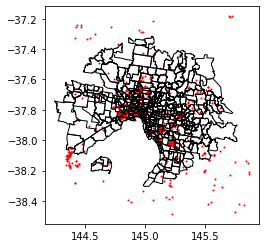

In [46]:
# Plot map with points in red
base = suburbs.boundary.plot(linewidth=1, edgecolor="black")
points.plot(ax=base, linewidth=1, color="red", markersize=1)
plt.show()

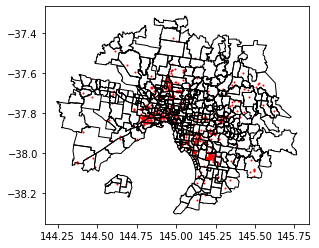

In [47]:
# Plot map with points in red
base = suburbs.boundary.plot(linewidth=1, edgecolor="black")
pointInPolys.plot(ax=base, linewidth=1, color="red", markersize=1)
plt.show()

In [48]:
counts = pointInPolys['index_right'].value_counts()

In [49]:
counts

Dandenong South       58
Laverton North        37
Campbellfield         22
Thomastown            20
Brooklyn              15
                      ..
Brunswick              1
Moorooduc              1
Narre Warren North     1
Ringwood East          1
Whittlesea             1
Name: index_right, Length: 182, dtype: int64

In [50]:
suburbData["counts"] = counts
suburbData

,geometry,counts
LOC_NAME,,
Melbourne,"POLYGON ((144.97797 -37.83867, 144.97803 -37.8...",2.0
St Kilda,"POLYGON ((144.99038 -37.87073, 144.99036 -37.8...",NaN
Southbank,"POLYGON ((144.95308 -37.82740, 144.95328 -37.8...",1.0
Woori Yallock,"POLYGON ((145.56403 -37.79782, 145.56412 -37.7...",NaN
Carlton,"POLYGON ((144.97401 -37.80311, 144.97320 -37.8...",2.0
...,...,...
Grangefields,"POLYGON ((144.64630 -37.70140, 144.64632 -37.7...",NaN
Wesburn,"POLYGON ((145.60867 -37.77043, 145.60842 -37.7...",NaN
Steels Creek,"POLYGON ((145.39431 -37.59546, 145.39427 -37.5...",NaN


In [51]:
pointInPolys.groupby(['index_right']).agg(['count'])

,0,1,2,coords
,count,count,count,count
index_right,,,,
Abbotsford,2,2,2,2
Airport West,1,1,1,1
Albion,4,4,4,4
Alphington,1,1,1,1
Altona,13,13,13,13
...,...,...,...,...
Yan Yean,1,1,1,1
Yarra Glen,2,2,2,2


In [52]:
dfGrouped = pointInPolys.groupby(['index_right']).agg(['count'])[0]['count']
dfGrouped

index_right
Abbotsford         2
Airport West       1
Albion             4
Alphington         1
Altona            13
                  ..
Yan Yean           1
Yarra Glen         2
Yarra Junction     1
Yarrambat          1
Yarraville        10
Name: count, Length: 182, dtype: int64

In [53]:
suburbData["suburb"] = suburbData.index
suburbData

,geometry,counts,suburb
LOC_NAME,,,
Melbourne,"POLYGON ((144.97797 -37.83867, 144.97803 -37.8...",2.0,Melbourne
St Kilda,"POLYGON ((144.99038 -37.87073, 144.99036 -37.8...",NaN,St Kilda
Southbank,"POLYGON ((144.95308 -37.82740, 144.95328 -37.8...",1.0,Southbank
Woori Yallock,"POLYGON ((145.56403 -37.79782, 145.56412 -37.7...",NaN,Woori Yallock
Carlton,"POLYGON ((144.97401 -37.80311, 144.97320 -37.8...",2.0,Carlton
...,...,...,...
Grangefields,"POLYGON ((144.64630 -37.70140, 144.64632 -37.7...",NaN,Grangefields
Wesburn,"POLYGON ((145.60867 -37.77043, 145.60842 -37.7...",NaN,Wesburn
Steels Creek,"POLYGON ((145.39431 -37.59546, 145.39427 -37.5...",NaN,Steels Creek


In [69]:
#bins = np.histogram(dfGrouped, bins=6)[1]
bins = [0, 5, 10, 15, 100]

In [70]:
pd.to_pickle(suburbData, "./pollutantData.pkl")

### Map

In [85]:
# Create a base map
m = folium.Map(location=[-37.810612, 144.963954], tiles='cartodbpositron', zoom_start=11)

# Add a choropleth map to the base map
Choropleth(geo_data=suburbs.__geo_interface__, 
           data=dfGrouped, 
           key_on="feature.id", 
           fill_color='YlGnBu', line_opacity=0.9,
           threshold_scale = bins,
           legend_name='Number of Pollutants per Suburb'
          ).add_to(m)

# Display the map
#m

In [86]:
mymap = m

In [87]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

NIL = folium.features.GeoJson(
    suburbData,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['suburb','counts'],
        aliases=['Suburb: ','Number of Pollutants: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
mymap.add_child(NIL)
mymap.keep_in_front(NIL)
folium.LayerControl().add_to(mymap)
mymap